In [31]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, accuracy_score
from sklearn.tree import plot_tree
from matplotlib import pyplot as plt
import pydot
import graphviz
from ipywidgets import interactive
from IPython.display import SVG,display
from sklearn.tree import export_graphviz

In [ ]:
colab = True

if colab:
  df = pd.read_pickle("/content/saeb_treated.pkl")

df

,ano,sigla_uf,escola_publica,id_aluno,situacao_censo,disciplina,proficiencia,erro_padrao,proficiencia_saeb,erro_padrao_saeb,...,frequenta_festas_comunidade,gosta_estudar_disciplina,faz_licao_casa,correcao_licao_casa,utiliza_biblioteca_escola,rede,id_escola,serie,turno,desempenho_aluno_cat
274,2015,PB,1,17518688,0,MT,-0.472096,0.538400,223.577837,30.092429,...,1.0,1.0,2.0,2.0,0.0,2,25077147,9,1,0
348,2015,PB,1,17518163,0,MT,-0.809452,0.580177,204.722224,32.427443,...,1.0,0.0,1.0,2.0,1.0,2,61135320,9,1,0
408,2015,PB,1,17491526,0,LP,-0.828752,0.366511,204.326255,20.192323,...,NaN,1.0,1.0,2.0,1.0,2,25034820,9,1,1
1594,2015,PB,1,17489545,0,MT,-0.069178,0.583999,246.097862,32.641064,...,1.0,1.0,0.0,2.0,0.0,2,25030620,9,2,1
1847,2015,PB,1,17561474,0,MT,-0.462874,0.543093,224.093276,30.354732,...,2.0,1.0,NaN,2.0,2.0,2,25120760,9,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93241,2017,PB,1,23097314,1,LP,-0.014796,0.299444,249.169829,16.497377,...,2.0,0.0,1.0,2.0,0.0,2,61183637,9,1,1
93246,2017,PB,1,23078187,1,MT,-1.526647,0.565242,164.636526,31.592691,...,1.0,1.0,2.0,2.0,1.0,2,61199440,9,2,0
93247,2017,PB,1,23124256,1,LP,-1.014805,0.481469,194.075970,26.525746,...,2.0,0.0,1.0,2.0,0.0,2,61218529,9,1,0
93248,2017,PB,1,23124256,1,MT,-1.026776,0.534742,192.575480,29.887975,...,2.0,1.0,2.0,2.0,0.0,2,61218529,9,1,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 84174 entries, 274 to 93249
Data columns (total 47 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   ano                                            84174 non-null  Int64  
 1   sigla_uf                                       84174 non-null  object 
 2   escola_publica                                 84174 non-null  int64  
 3   id_aluno                                       84174 non-null  object 
 4   situacao_censo                                 84174 non-null  Int64  
 5   disciplina                                     84174 non-null  object 
 6   proficiencia                                   84174 non-null  float64
 7   erro_padrao                                    84174 non-null  float64
 8   proficiencia_saeb                              84174 non-null  float64
 9   erro_padrao_saeb                               84174 

In [ ]:
# dropar linhas com valores nulos
df = df.dropna()
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50356 entries, 27111 to 93249
Data columns (total 47 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   ano                                            50356 non-null  Int64  
 1   sigla_uf                                       50356 non-null  object 
 2   escola_publica                                 50356 non-null  int64  
 3   id_aluno                                       50356 non-null  object 
 4   situacao_censo                                 50356 non-null  Int64  
 5   disciplina                                     50356 non-null  object 
 6   proficiencia                                   50356 non-null  float64
 7   erro_padrao                                    50356 non-null  float64
 8   proficiencia_saeb                              50356 non-null  float64
 9   erro_padrao_saeb                               5035

In [ ]:
exclude = ['ano', 'sigla_uf', 'id_aluno', 'situacao_censo', 'disciplina', 'proficiencia', 'erro_padrao', 'proficiencia_saeb',
       'erro_padrao_saeb', 'sexo', 'raca_cor','ano_nascimento', 'rede', 'id_escola', 'serie', 'turno', 'escola_publica', 'desempenho_aluno', 'desempenho_aluno_cat']

In [ ]:
df = df[df['disciplina'] == 'MT']

In [ ]:
# transforming target

median = df['proficiencia'].median()

df['target'] = np.where(df['proficiencia'] >= median, 1, 0)
df['target'].value_counts()

,count
target,
0,12604
1,12604


In [ ]:
X = df.drop(columns=exclude + ['target'])
y = df['target']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=2698)

print("Tamanho treino: " + str(len(X_train)))
print("Tamanho teste: " + str(len(X_test)))

scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

Tamanho treino: 20166
Tamanho teste: 5042


In [ ]:
clf = DecisionTreeClassifier()
clf.fit(X_train, y_train)

print('Ein: %0.4f' % (1 - accuracy_score(y_train, clf.predict(X_train))))
print('Eout: %0.4f' % (1 - accuracy_score(y_test, clf.predict(X_test))))
print(classification_report(y_test, clf.predict(X_test)))

Ein: 0.0003
Eout: 0.4508
              precision    recall  f1-score   support

           0       0.55      0.55      0.55      2521
           1       0.55      0.55      0.55      2521

    accuracy                           0.55      5042
   macro avg       0.55      0.55      0.55      5042
weighted avg       0.55      0.55      0.55      5042



In [ ]:
X.columns

Index(['idade', 'escolaridade_mae', 'mae_sabe_ler_escrever', 'mae_le',
       'escolaridade_pai', 'pai_sabe_ler_escrever', 'pai_le',
       'responsaveis_incentivam_realizacao_licao_casa',
       'responsaveis_incentivam_estudos', 'responsaveis_incentivam_leitura',
       'responsaveis_incentivam_comparecer_aulas', 'possui_computador',
       'tempo_lazer', 'leitura_jornais', 'leitura_livros_geral',
       'leitura_literatura_infantojuvenil', 'leitura_historia_quadrinhos',
       'leitura_revista_comportamento', 'leitura_revistas_geral',
       'leitura_internet', 'frequenta_biblioteca', 'frequenta_cinema',
       'frequenta_espetaculo_exposicao', 'frequenta_festas_comunidade',
       'gosta_estudar_disciplina', 'faz_licao_casa', 'correcao_licao_casa',
       'utiliza_biblioteca_escola'],
      dtype='object')

idade:0.0631586340762679
escolaridade_mae:0.06610610510307365
mae_sabe_ler_escrever:0.008352336623990137
mae_le:0.01689545730848505
escolaridade_pai:0.0762677826258948
pai_sabe_ler_escrever:0.01752924126071654
pai_le:0.027533950013448303
responsaveis_incentivam_realizacao_licao_casa:0.009745597326758662
responsaveis_incentivam_estudos:0.003209238320235552
responsaveis_incentivam_leitura:0.013464333878298436
responsaveis_incentivam_comparecer_aulas:0.004252805713864269
possui_computador:0.04416927992699878
tempo_lazer:0.06812501796977456
leitura_jornais:0.036075626750287665
leitura_livros_geral:0.03830125399513214
leitura_literatura_infantojuvenil:0.04485507964824306
leitura_historia_quadrinhos:0.050638505520837596
leitura_revista_comportamento:0.03664261518080761
leitura_revistas_geral:0.04475575477019408
leitura_internet:0.04496006573396278
frequenta_biblioteca:0.04124629609857545
frequenta_cinema:0.038838634912254005
frequenta_espetaculo_exposicao:0.03577087710884302
frequenta_festas

<BarContainer object of 28 artists>

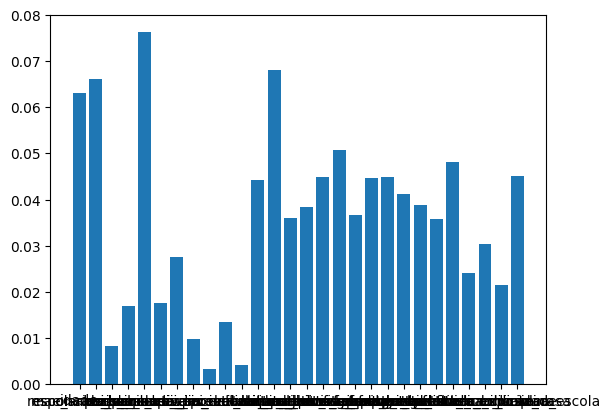

In [ ]:
for feature, importance in zip(X.columns, clf.feature_importances_):
    print("{}:{}".format(feature, importance))

plt.bar(X.columns, clf.feature_importances_)

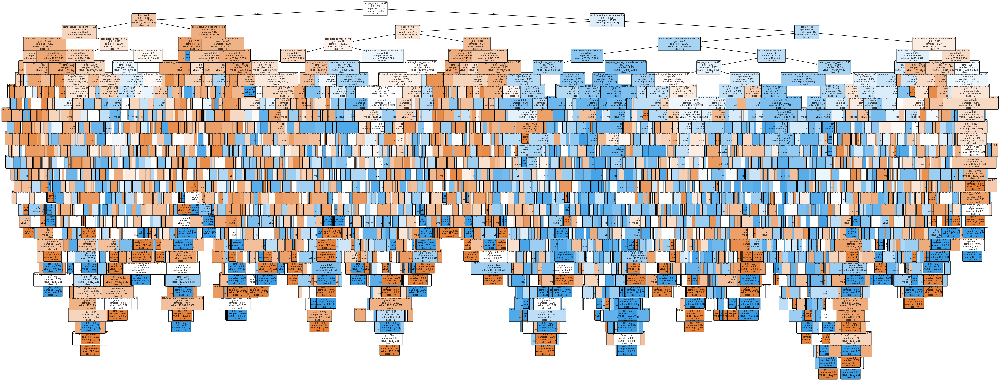

In [ ]:
# feature labels
features_label = X.columns

# class label
class_label = ['0','1']

plt.figure(figsize=(50,20))
plot_tree(
    clf,
    feature_names = features_label,
    class_names = class_label,
    filled=True,
    proportion = True,
    fontsize=6,
    rounded = True)

plt.savefig('filename.png')

In [ ]:
dot_data = export_graphviz(
         clf,
         out_file = None,
         feature_names = features_label,
         class_names = class_label,
         filled = True,
         rounded = True,
         proportion = True,
         node_ids = True,
         rotate  =False,
         label = 'all',
         special_characters = True
        )
graph = graphviz.Source(dot_data)
graph

In [33]:
def plot_tree(crit, split, depth, min_samples_split, min_samples_leaf=0.2):
    estimator = DecisionTreeClassifier(
           random_state = 0
          ,criterion = crit
          ,splitter = split
          ,max_depth = depth
          ,min_samples_split=min_samples_split
          ,min_samples_leaf=min_samples_leaf
    )
    estimator.fit(X_train, y_train)

    print('Ein: %0.4f' % (1 - accuracy_score(y_train, estimator.predict(X_train))))
    print('Eout: %0.4f' % (1 - accuracy_score(y_test, estimator.predict(X_test))))

    print(classification_report(y_test, estimator.predict(X_test)))
    graph = graphviz.Source(export_graphviz(estimator
      , out_file=None
      , feature_names=features_label
      , class_names=class_label
      , impurity=True
      , filled = True))

    display(SVG(graph.pipe(format='svg')))
    return estimator

inter=interactive(plot_tree
   , crit = ["gini", "entropy"]
   , split = ["best", "random"]
   , depth=[1,2,3,4,5,10,20,30]
   , min_samples_split=(1,8)
   , min_samples_leaf=(1,20))

display(inter)

interactive(children=(Dropdown(description='crit', options=('gini', 'entropy'), value='gini'), Dropdown(descri…